In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# Use Geopandas for spatial data analysis if needed (you will need to install it)
import geopandas as gpd
from shapely.geometry import Point

# Load your data
df_2018 = pd.read_csv('/Users/amandah/Downloads/data_2018.csv')
df_2019 = pd.read_csv('/Users/amandah/Downloads/data_2019.csv')
df_2020 = pd.read_csv('/Users/amandah/Downloads/data_2020.csv')
df_2021 = pd.read_csv('/Users/amandah/Downloads/data_2021.csv')
df_2022 = pd.read_csv('/Users/amandah/Downloads/data_2022.csv')
df_2023 = pd.read_csv('/Users/amandah/Downloads/data_2023.csv')

In [4]:
df = pd.concat([df_2018, df_2019, df_2020, df_2021, df_2022, df_2023])
df['date'] = pd.to_datetime(df['date'])

In [5]:
incidents_per_year = df.groupby(df['date'].dt.year).size()

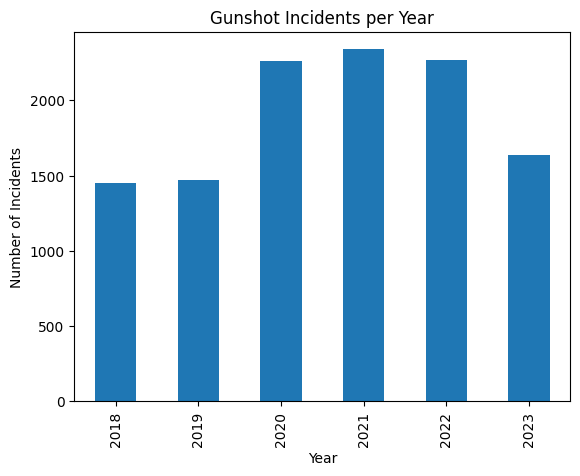

In [6]:
incidents_per_year.plot(kind='bar')
plt.xlabel('Year')
plt.ylabel('Number of Incidents')
plt.title('Gunshot Incidents per Year')
plt.show()

In [7]:
ethnicity_per_year = df.groupby([df['date'].dt.year, 'race']).size().unstack().fillna(0)
age_per_year = df.groupby([df['date'].dt.year, 'age']).size().unstack().fillna(0)


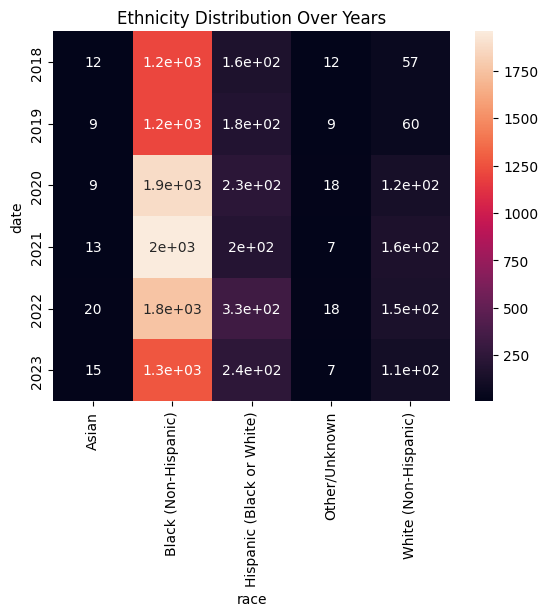

In [8]:
sns.heatmap(ethnicity_per_year, annot=True)
plt.title('Ethnicity Distribution Over Years')
plt.show()

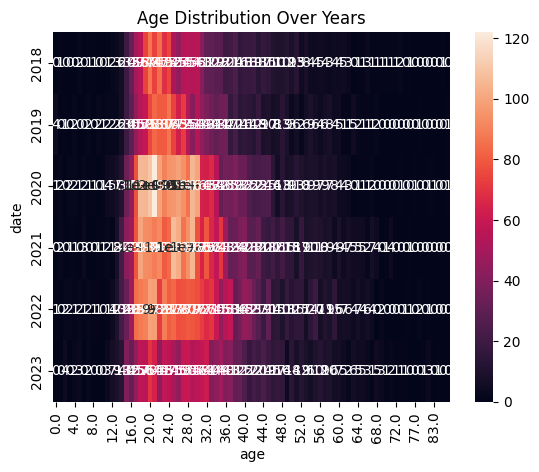

In [9]:
sns.heatmap(age_per_year, annot=True)
plt.title('Age Distribution Over Years')
plt.show()

In [10]:
gdf = gpd.read_file('/Users/amandah/Downloads/Census_Tracts_20101.geojson')
gdf.head()

,OBJECTID,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,LOGRECNO,geometry
0,1,42,101,009400,42101009400,94,Census Tract 94,G5020,S,366717,0,+39.9632709,-075.2322437,10429,"POLYGON ((-75.22927 39.96054, -75.22865 39.960..."
1,2,42,101,009500,42101009500,95,Census Tract 95,G5020,S,319070,0,+39.9658709,-075.2379140,10430,"POLYGON ((-75.23536 39.96852, -75.23545 39.969..."
2,3,42,101,009600,42101009600,96,Census Tract 96,G5020,S,405273,0,+39.9655396,-075.2435075,10431,"POLYGON ((-75.24343 39.96230, -75.24339 39.962..."
3,4,42,101,013800,42101013800,138,Census Tract 138,G5020,S,341256,0,+39.9764504,-075.1771771,10468,"POLYGON ((-75.17341 39.97779, -75.17386 39.977..."
4,5,42,101,013900,42101013900,139,Census Tract 139,G5020,S,562934,0,+39.9750563,-075.1711846,10469,"POLYGON ((-75.17313 39.97776, -75.17321 39.977..."


In [11]:
gdf_gunshot = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df.lng, df.lat))
gdf_gunshot.crs = {'init': 'epsg:4326'}
gdf_joined = gpd.sjoin(gdf_gunshot, gdf, how='inner', op='within')


/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/2294377261.py:3: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg:

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

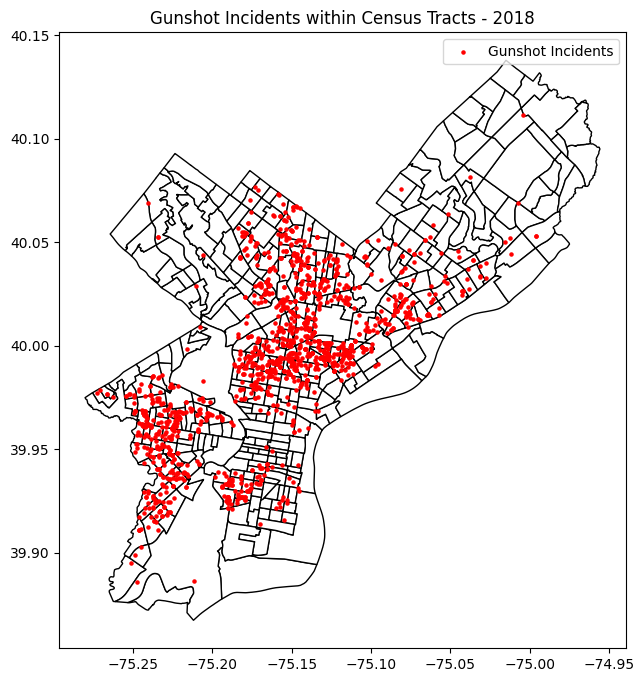

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

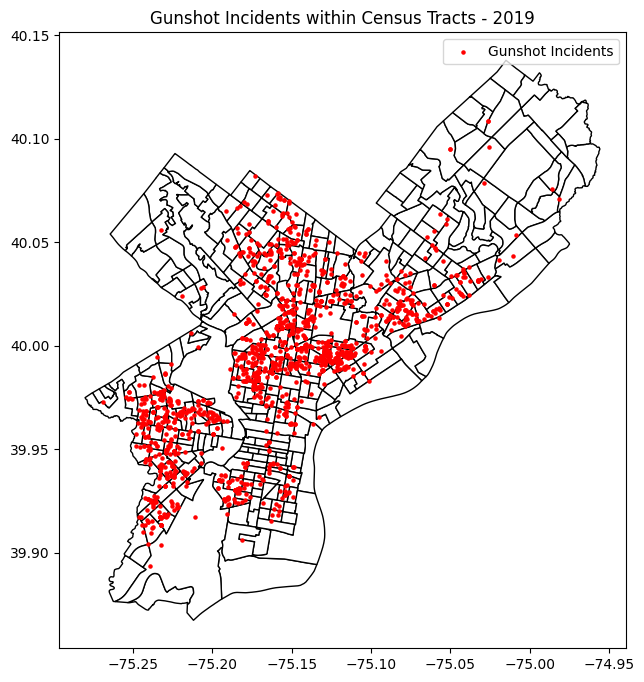

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

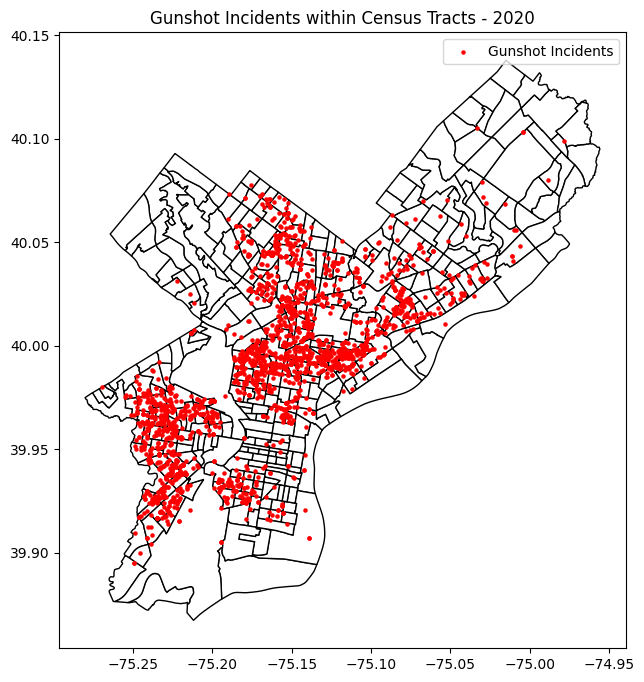

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

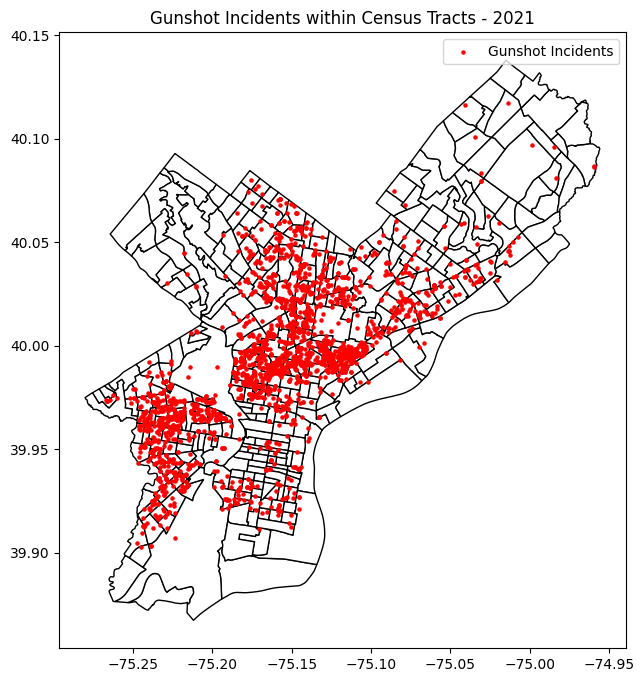

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

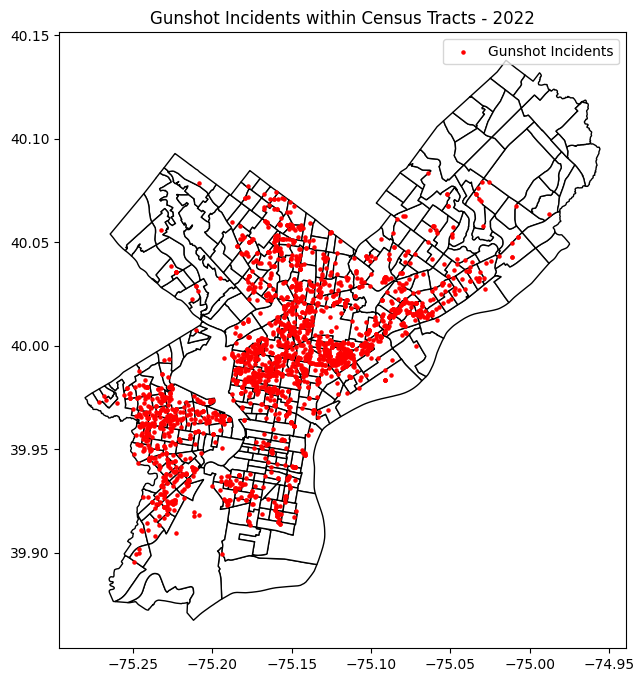

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3550: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  exec(code_obj, self.user_global_ns, self.user_ns)
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/3834472744.py:11: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg

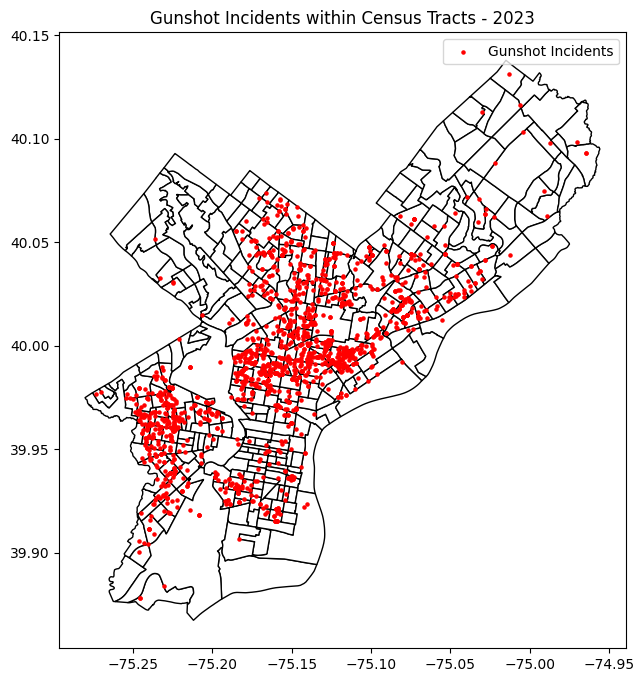

In [12]:
# Function to filter the data for a given year and perform a spatial join with the census tracts
def prepare_data_for_year(df, gdf_tracts, year):
    # Filter the dataframe for the given year
    df_year = df[df['date'].dt.year == year]
    
    # Convert the filtered DataFrame to a GeoDataFrame
    gdf_gunshot_year = gpd.GeoDataFrame(df_year, geometry=gpd.points_from_xy(df_year.lng, df_year.lat))
    gdf_gunshot_year.crs = {'init': 'epsg:4326'}
    
    # Perform the spatial join
    gdf_joined_year = gpd.sjoin(gdf_gunshot_year, gdf_tracts, how='inner', op='within')
    return gdf_joined_year

# Function to plot the data
def plot_data_for_year(gdf_tracts, gdf_joined, year):
    fig, ax = plt.subplots(1, figsize=(12, 8))
    gdf_tracts.plot(ax=ax, color='white', edgecolor='black')
    gdf_joined.plot(ax=ax, marker='o', color='red', markersize=5, label='Gunshot Incidents')
    plt.title(f'Gunshot Incidents within Census Tracts - {year}')
    plt.legend()
    plt.show()

# Iterate over each year and create the visualizations
for year in range(2018, 2024):
    gdf_joined_year = prepare_data_for_year(df, gdf, year)
    plot_data_for_year(gdf, gdf_joined_year, year)

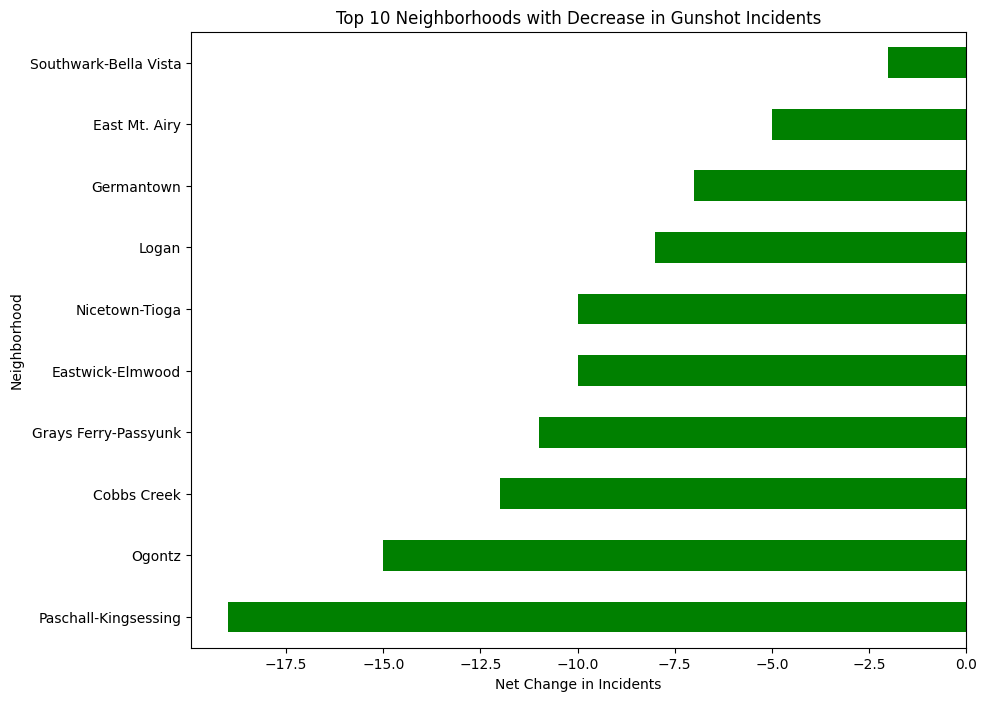

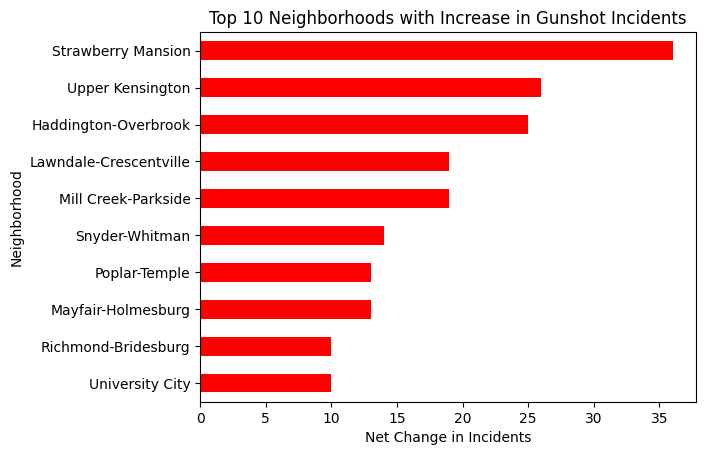

In [13]:
# First, let's create a 'year' column in the df dataframe to facilitate analysis.
df['year'] = df['date'].dt.year

# Now, let's calculate the number of incidents per neighborhood per year.
incidents_per_neighborhood_year = df.groupby(['neighborhood', 'year']).size().unstack(fill_value=0)

# Next, we want to calculate the rate of change for each neighborhood.
# We will do a simple subtraction between the first and last year to see the net change.
# More sophisticated methods could involve percentage change or yearly average change, depending on the analysis requirement.
change = incidents_per_neighborhood_year[2023] - incidents_per_neighborhood_year[2018]

# Sort neighborhoods by the amount of change to find out which increased or decreased the most.
sorted_neighborhoods = change.sort_values()

# Now let's visualize the neighborhoods with the most significant increase and decrease in incidents.
plt.figure(figsize=(10, 8))

# Plot the neighborhoods with the greatest decrease
decreased = sorted_neighborhoods.head(10)
decreased.plot(kind='barh', color='green')
plt.title('Top 10 Neighborhoods with Decrease in Gunshot Incidents')
plt.xlabel('Net Change in Incidents')
plt.ylabel('Neighborhood')
plt.show()

# Plot the neighborhoods with the greatest increase
increased = sorted_neighborhoods.tail(10)
increased.plot(kind='barh', color='red')
plt.title('Top 10 Neighborhoods with Increase in Gunshot Incidents')
plt.xlabel('Net Change in Incidents')
plt.ylabel('Neighborhood')
plt.show()


/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/pyproj/crs/crs.py:141: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)
/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3490: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_22622/4275879911.py:5: UserWarning: CRS mismatch between the CRS of left geometries and the CRS of right geometries.
Use `to_crs()` to reproject one of the input geometries to match the CRS of the other.

Left CRS: +init=epsg:

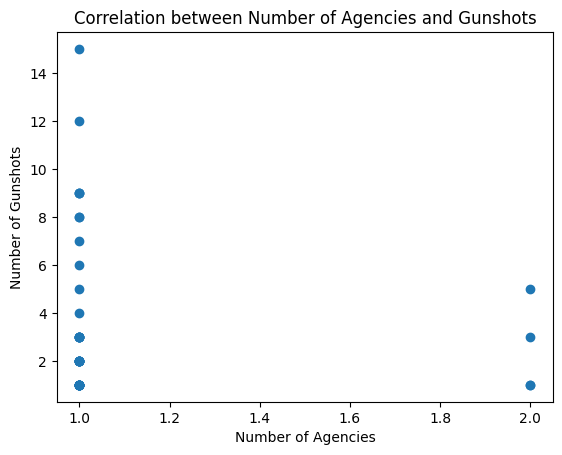

               GEOID10_x  agency_count  GEOID10_y  gunshot_count
GEOID10_x       1.000000      0.291415   0.988164       0.428917
agency_count    0.291415      1.000000   0.277408      -0.115650
GEOID10_y       0.988164      0.277408   1.000000       0.377097
gunshot_count   0.428917     -0.115650   0.377097       1.000000


In [14]:
resources_df = pd.read_csv('/Users/amandah/Downloads/NeighborhoodResources.csv')

gdf_resources = gpd.GeoDataFrame(resources_df, geometry=gpd.points_from_xy(resources_df.X, resources_df.Y))
gdf_resources.crs = {'init': 'epsg:4326'}
gdf_resources_tracts = gpd.sjoin(gdf_resources, gdf, how='inner', op='within')

agency_count_per_tract = gdf_resources_tracts.groupby('GEOID10').size()
gdf_gunshot_2023 = gdf_gunshot[gdf_gunshot['date'].dt.year == 2023]
gdf_gunshot_tracts_2023 = gpd.sjoin(gdf_gunshot_2023, gdf, how='inner', op='within')

gunshot_count_per_tract_2023 = gdf_gunshot_tracts_2023.groupby('GEOID10').size()

agency_count_per_tract_df = agency_count_per_tract.reset_index(name='agency_count')

# Do the same for the gunshot counts
gunshot_count_per_tract_2023_df = gunshot_count_per_tract_2023.reset_index(name='gunshot_count')


merged_data = pd.merge(agency_count_per_tract_df, gunshot_count_per_tract_2023_df, left_index=True, right_index=True, how='inner')

# Perform correlation analysis
correlation = merged_data.corr()

# Visualize the relationship with a scatter plot
plt.scatter(merged_data['agency_count'], merged_data['gunshot_count'])
plt.xlabel('Number of Agencies')
plt.ylabel('Number of Gunshots')
plt.title('Correlation between Number of Agencies and Gunshots')
plt.show()

# Output the correlation
print(correlation)


In [15]:
acs_data = pd.read_csv('/Users/amandah/Downloads/ACSDP5Y2022.DP05_2023-12-26T165832/ACSDP5Y2022.DP05-Data.csv')
acs_data['GEO_ID'] = acs_data['GEO_ID'].astype(str)
# Make sure the GEOID10 columns match in format and type
gdf_gunshot_tracts_2023['GEOID10'] = gdf_gunshot_tracts_2023['GEOID10'].astype(str)

# Select relevant socioeconomic columns from ACS data (update these column names based on your actual ACS data)
socioeconomic_columns = [
    'GEO_ID',
    'DP05_0001E',  # Total population
    'DP05_0002E',
    'DP05_0003E',
    'DP05_0002E',
    'DP05_0037E', # Race - White alone
    'DP05_0038E', #Race - Black or African American alone
    'DP05_0039E', #Race - American Indian and Alaska Native alone
    'DP05_0044E', #Race - Asian alone
    'DP05_0052E',# Race - Two or more races
    'DP05_0018E']

acs_datasocioeconomic_vars = acs_data[socioeconomic_columns]

merged_data = pd.merge(gdf_gunshot_tracts_2023, acs_datasocioeconomic_vars, left_on='GEOID10', right_on='GEO_ID', how='inner')


In [16]:
correlation_matrix = merged_data.corr()
print(correlation_matrix)

                  dc_key  race  sex  fatal  date  has_court_case  age  \
dc_key               NaN   NaN  NaN    NaN   NaN             NaN  NaN   
race                 NaN   NaN  NaN    NaN   NaN             NaN  NaN   
sex                  NaN   NaN  NaN    NaN   NaN             NaN  NaN   
fatal                NaN   NaN  NaN    NaN   NaN             NaN  NaN   
date                 NaN   NaN  NaN    NaN   NaN             NaN  NaN   
has_court_case       NaN   NaN  NaN    NaN   NaN             NaN  NaN   
age                  NaN   NaN  NaN    NaN   NaN             NaN  NaN   
street_name          NaN   NaN  NaN    NaN   NaN             NaN  NaN   
block_number         NaN   NaN  NaN    NaN   NaN             NaN  NaN   
zip_code             NaN   NaN  NaN    NaN   NaN             NaN  NaN   
council_district     NaN   NaN  NaN    NaN   NaN             NaN  NaN   
police_district      NaN   NaN  NaN    NaN   NaN             NaN  NaN   
neighborhood         NaN   NaN  NaN    NaN   NaN   

In [17]:
import cenpy
import random
import requests
import pandas as pd

census_api_key = "49fa9e8021c52d4457397bd6bb938be7aeb6ebdb"
census_variables = "B19013_001E,NAME"
state='42'
tract = '*' 

base_url = "https://api.census.gov/data/2021/acs/acs5"
columns = census_variables
data_url = f'{base_url}?get={columns}&for=tract:{tract}&in=state:{state}&key={census_api_key}'


try:
    response = requests.get(data_url)
    data = response.json()
    header = data[0]
    rows = data[1:]
    
    df = pd.DataFrame(rows, columns=header)
    
except requests.exceptions.RequestException as e:
    print(f"Error in making the request: {e}")

/Users/amandah/Desktop/gopipelines/.conda/lib/python3.10/site-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


In [18]:
df=df[df['county']=='101']
df

,B19013_001E,NAME,state,county,tract
2558,104052,"Census Tract 1.01, Philadelphia County, Pennsy...",42,101,000101
2559,91944,"Census Tract 1.02, Philadelphia County, Pennsy...",42,101,000102
2560,91067,"Census Tract 2, Philadelphia County, Pennsylvania",42,101,000200
2561,86782,"Census Tract 3, Philadelphia County, Pennsylvania",42,101,000300
2562,67188,"Census Tract 4.01, Philadelphia County, Pennsy...",42,101,000401
...,...,...,...,...,...
2961,-666666666,"Census Tract 9809.05, Philadelphia County, Pen...",42,101,980905
2962,-666666666,"Census Tract 9809.06, Philadelphia County, Pen...",42,101,980906
2963,-666666666,"Census Tract 9891, Philadelphia County, Pennsy...",42,101,989100
2964,-666666666,"Census Tract 9892, Philadelphia County, Pennsy...",42,101,989200


In [19]:
# Combine state, county, and tract codes to match the format in gdf_gunshot_tracts_2023
df['GEOID10'] = df['state'] + df['county'] + df['tract']

total_gunshot_counts = gdf_joined.groupby('GEOID10').size().reset_index(name='total_gunshot_count')
merged_data = pd.merge(
    total_gunshot_counts, 
    df[['GEOID10', 'B19013_001E']], 
    on='GEOID10', 
    how='left'
)

# Convert the median household income to numeric
merged_data['B19013_001E'] = pd.to_numeric(merged_data['B19013_001E'], errors='coerce').fillna(0)
merged_data=merged_data[merged_data['B19013_001E']>0]

correlation_matrix = merged_data[['total_gunshot_count', 'B19013_001E']].corr()

# Print the correlation matrix
print(correlation_matrix)


                     total_gunshot_count  B19013_001E
total_gunshot_count             1.000000    -0.535596
B19013_001E                    -0.535596     1.000000


In [20]:
import requests
import pandas as pd

# Census API details
census_api_key = "49fa9e8021c52d4457397bd6bb938be7aeb6ebdb"
state = '42'  # Pennsylvania
tract = '*'
county = '101'  # Philadelphia County
base_url = "https://api.census.gov/data/2016/acs/acs1"  # Using 2016 data as per your specification


# Include the variable for educational attainment
census_variables = "DP02_0060PE,NAME"  # DP02_0060PE: Percent of population 25+ without a high school diploma

# Construct the API request URL
data_url = f'{base_url}?get={census_variables}&for=tract:{tract}&in=state:{state}&key={census_api_key}'

# Fetch the data
try:
    response = requests.get(data_url)
    data = response.json()
    print(data)
    header = data[0]
    rows = data[1:]
    df = pd.DataFrame(rows, columns=header)
    df['GEOID10'] = df['state'] + df['county'] + df['tract']
except requests.exceptions.RequestException as e:
    print(response)
    print(f"Error in making the request: {e}")

<Response [400]>
Error in making the request: Expecting value: line 1 column 1 (char 0)


In [21]:


# Merge with gunshot data
total_gunshot_counts = gdf_joined.groupby('GEOID10').size().reset_index(name='total_gunshot_count')
merged_data = pd.merge(total_gunshot_counts, df[['GEOID10', 'DP02_0060PE']], on='GEOID10', how='left')

# Convert the educational attainment variable to numeric
merged_data['DP02_0060PE'] = pd.to_numeric(merged_data['DP02_0060PE'], errors='coerce').fillna(0)

# Perform correlation analysis
correlation_matrix2 = merged_data[['total_gunshot_count', 'DP02_0060PE']].corr()

# Print the correlation matrix
print(correlation_matrix2)

KeyError: "['DP02_0060PE'] not in index"

In [ ]:
# Merge with gunshot data
total_gunshot_counts = gdf_joined.groupby('GEOID10').size().reset_index(name='total_gunshot_count')
merged_data = pd.merge(total_gunshot_counts, df[['GEOID10', 'B19013_001E', 'DP02_0060E']], on='GEOID10', how='left')

# Convert columns to numeric
merged_data['B19013_001E'] = pd.to_numeric(merged_data['B19013_001E'], errors='coerce').fillna(0)
merged_data['DP02_0060E'] = pd.to_numeric(merged_data['DP02_0060E'], errors='coerce').fillna(0)
merged_data = merged_data[merged_data['B19013_001E'] > 0]

# Perform correlation analysis
correlation_matrix = merged_data[['total_gunshot_count', 'B19013_001E', 'DP02_0060E']].corr()

# Print the correlation matrix
print(correlation_matrix)

Socioeconomic Factors: The negative correlation suggests a relationship where higher-income areas may have fewer gunshot incidents. This could be due to a variety of factors, including differences in law enforcement, community resources, educational opportunities, etc.

Urban Planning and Development: Higher-income areas might have different urban planning and community resources that contribute to lower crime rates.

Causation vs. Correlation: It's important to note that correlation does not imply causation. While there's a correlation between median household income and gunshot incidents, this doesn't necessarily mean that income directly causes changes in gunshot incident rates. There could be other underlying factors at play.

Further Analysis: To understand the dynamics better, you might consider additional variables like educational attainment, employment rates, access to healthcare, and more. Multivariate analysis or regression models could provide more insights.

Policy Implications: This information could be valuable for policymakers. For instance, focusing resources and community development efforts in lower-income areas might be a strategy to address the higher incidence of gunshot cases.

Data Quality and Context: Ensure the data quality is high and consider the context. For instance, if certain tracts have very few residents, a small number of incidents could show up as significant statistically.

In summary, the correlation suggests a meaningful relationship between income and gunshot incidents, but it's essential to explore the context and other factors to understand the full picture. This insight could be a starting point for more comprehensive socio-economic studies or policy development.

In [ ]:
merged_data

,GEOID10,gunshot_count,B19013_001E
0,42101000100,1,NaN
1,42101000200,2,91067
2,42101000401,1,67188
3,42101000402,1,NaN
4,42101000500,1,51801
...,...,...,...
273,42101980100,1,96181
274,42101980400,2,-666666666
275,42101980500,1,-666666666
276,42101980700,2,NaN


In [ ]:
gdf_gunshot

,dc_key,race,sex,fatal,date,has_court_case,age,street_name,block_number,zip_code,council_district,police_district,neighborhood,house_district,senate_district,school_catchment,lng,lat,geometry
0,201825101756,Hispanic (Black or White),Male,Nonfatal,2018-12-30 22:35:00,No,19.0,W ERIE AVE,600.0,19140.0,7.0,25.0,Hunting Park-Fairhill,197.0,3.0,Bayard Taylor School,-75.139438,40.007823,POINT (-75.13944 40.00782)
1,201825101757,Hispanic (Black or White),Male,Nonfatal,2018-12-30 22:35:00,No,17.0,W ERIE AVE,600.0,19140.0,7.0,25.0,Hunting Park-Fairhill,197.0,3.0,Bayard Taylor School,-75.139438,40.007823,POINT (-75.13944 40.00782)
2,201825101755,Hispanic (Black or White),Male,Nonfatal,2018-12-30 22:35:00,No,19.0,W ERIE AVE,600.0,19140.0,7.0,25.0,Hunting Park-Fairhill,197.0,3.0,Bayard Taylor School,-75.139438,40.007823,POINT (-75.13944 40.00782)
3,201825101726,Black (Non-Hispanic),Male,Nonfatal,2018-12-30 20:42:00,No,19.0,N MARVINE ST,3600.0,19140.0,5.0,25.0,Hunting Park-Fairhill,197.0,3.0,Mary M. Bethune School,-75.147031,40.007105,POINT (-75.14703 40.00711)
4,201801048162,Black (Non-Hispanic),Male,Nonfatal,2018-12-30 16:27:00,No,18.0,S 25TH ST,2300.0,19145.0,2.0,1.0,Grays Ferry-Passyunk,186.0,8.0,Stephen Girard School,-75.188467,39.923824,POINT (-75.18847 39.92382)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1634,202325019824,Hispanic (Black or White),Male,Fatal,2023-04-04 22:38:00,No,39.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT EMPTY
1635,202325019824,Hispanic (Black or White),Male,Nonfatal,2023-04-04 22:38:00,No,28.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT EMPTY
1636,202325019824,Hispanic (Black or White),Male,Nonfatal,2023-04-04 22:38:00,No,32.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT EMPTY
1637,202325019824,Hispanic (Black or White),Male,Nonfatal,2023-04-04 18:38:00,No,27.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,POINT EMPTY


In [1]:
import pandas as pd
incidents = pd.read_csv('incidents_part1_part2.csv')
incidents

,objectid,dc_dist,psa,dispatch_date_time,dispatch_date,dispatch_time,hour,dc_key,location_block,ucr_general,text_general_code,point_x,point_y,lat,lng
0,151849,22,NaN,2018-12-08 07:16:00+00,2018-12-08,02:16:00,2.0,2.018221e+11,N 29th St & Ridge Ave,300,Robbery No Firearm,-75.180807,39.986800,39.986800,-75.180807
1,151850,16,NaN,2018-07-12 01:26:00+00,2018-07-11,21:26:00,21.0,2.018160e+11,400 BLOCK N 50th St,400,Aggravated Assault No Firearm,-75.220113,39.964369,39.964369,-75.220113
2,151851,14,NaN,2018-02-26 06:28:00+00,2018-02-26,01:28:00,1.0,2.018140e+11,N 20th St & Wyncote Ave,300,Robbery Firearm,-75.150925,40.057370,40.057370,-75.150925
3,151853,17,NaN,2018-02-20 01:02:00+00,2018-02-19,20:02:00,20.0,2.018170e+11,2700 BLOCK Reed St,400,Aggravated Assault Firearm,-75.189692,39.935738,39.935738,-75.189692
4,151854,24,NaN,2018-09-20 23:31:00+00,2018-09-20,19:31:00,19.0,2.018241e+11,3500 BLOCK FRANKFORD AVE,500,Burglary Residential,-75.102406,39.997427,39.997427,-75.102406
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
154585,11706159,39,1,2018-12-15 05:00:00+00,2018-12-15,00:00:00,1.0,2.018391e+11,4900 BLOCK WAYNE AV,100,Homicide - Criminal,-75.167335,40.025180,40.025180,-75.167335
154586,11706160,15,2,2018-12-15 05:00:00+00,2018-12-15,00:00:00,19.0,2.018151e+11,6900 BLOCK TORRESDALE AV,100,Homicide - Criminal,-75.042701,40.026273,40.026273,-75.042701
154587,11706161,25,4,2018-12-19 05:00:00+00,2018-12-19,00:00:00,21.0,2.018251e+11,3000 BLOCK N 9TH ST,100,Homicide - Criminal,-75.144994,39.997686,39.997686,-75.144994
154588,11706162,24,2,2018-12-20 05:00:00+00,2018-12-20,00:00:00,5.0,2.018241e+11,3500 BLOCK JASPER ST,100,Homicide - Criminal,-75.104761,39.999058,39.999058,-75.104761


In [2]:
crimes_names = ['Homicide', 'Aggravated', 'Rape', 'Drunkenness', 'Narcotic', 'Prostitution', 'Conduct', 'Fraud', 'Vandalism', 'Robbery', 'Burglary', 'Theft']
crimes_labels = ['Homicide', 'Aggravated Assault', 'Rape', 'Public Drunkenness', 'Drug Law Violations', 'Prostitution','Disorderly Conduct', 'Fraud', 'Vandalism','Robbery','Burglary','Theft']

(-75.3, -74.9, 39.85, 40.15)

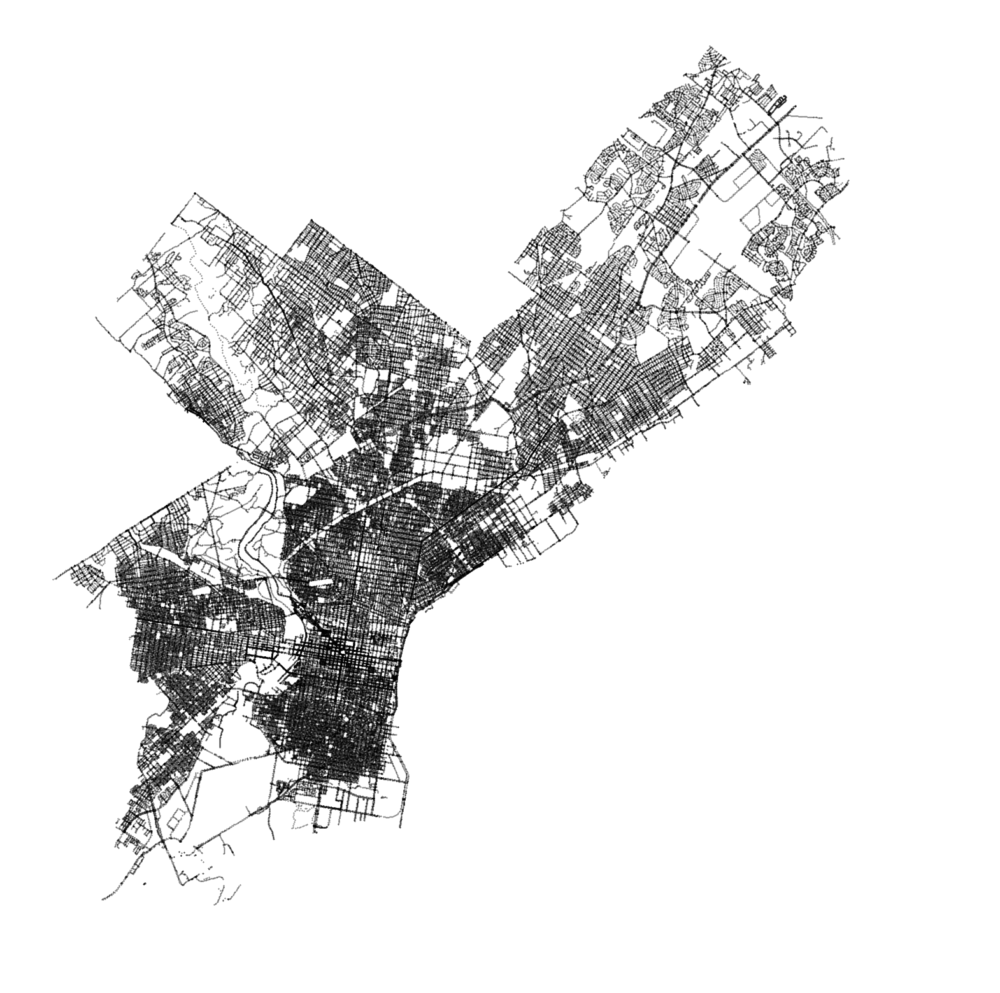

In [6]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pandas as pd

data_poles = pd.read_csv('Street_Poles.csv')
X_poles = data_poles['X'].values
Y_poles = data_poles['Y'].values

plt.figure(figsize=(20,20))
plt.scatter(X_poles,Y_poles,0.1,c='k')
plt.xlim(-75.3,-74.9)
plt.ylim(39.85,40.15)
plt.axis('off')

/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_26683/3033318570.py:18: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  colors = plt.cm.get_cmap('viridis', len(crimes_names))
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_26683/3033318570.py:49: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  plt.scatter(X_crime, Y_crime, 7, c=colors(k), vmax=np.percentile(z, 95))
/var/folders/tf/c5gvkllj6dn72kwhbbxxgcm40000gn/T/ipykernel_26683/3033318570.py:49: UserWarning: No data for colormapping provided via 'c'. Parameters 'vmax

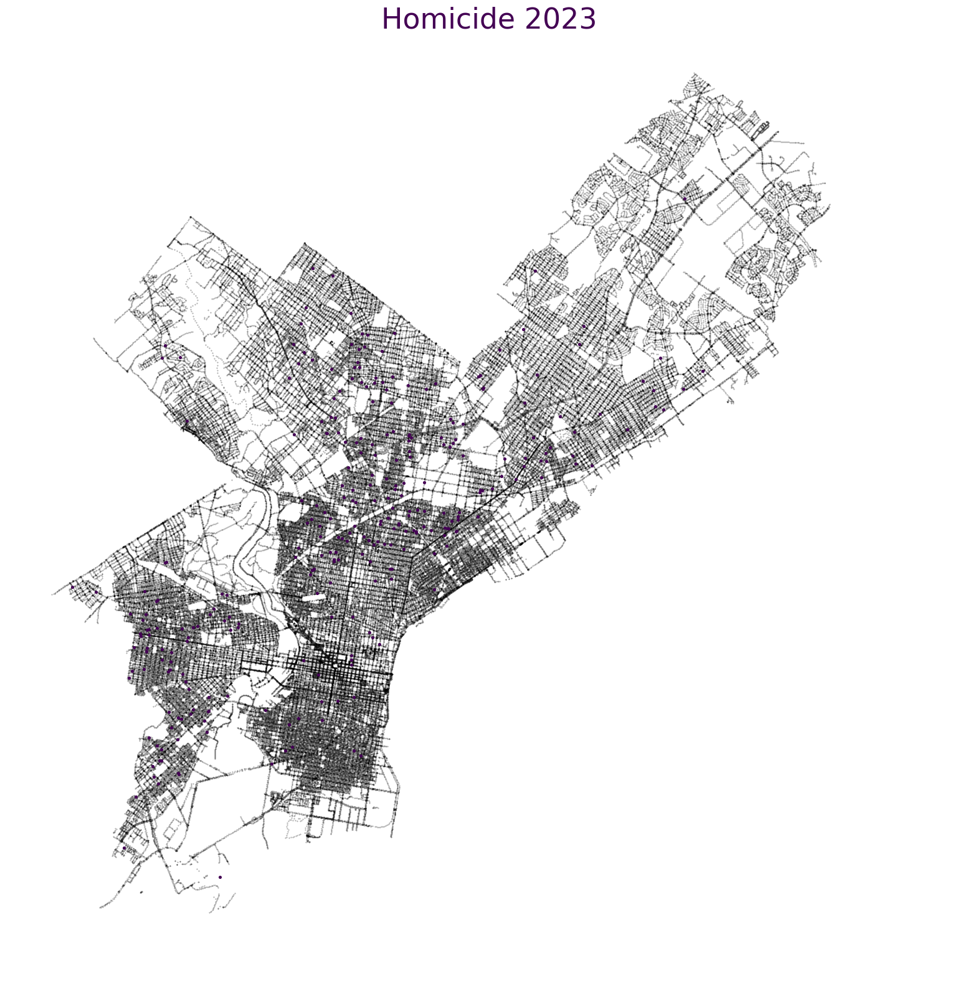

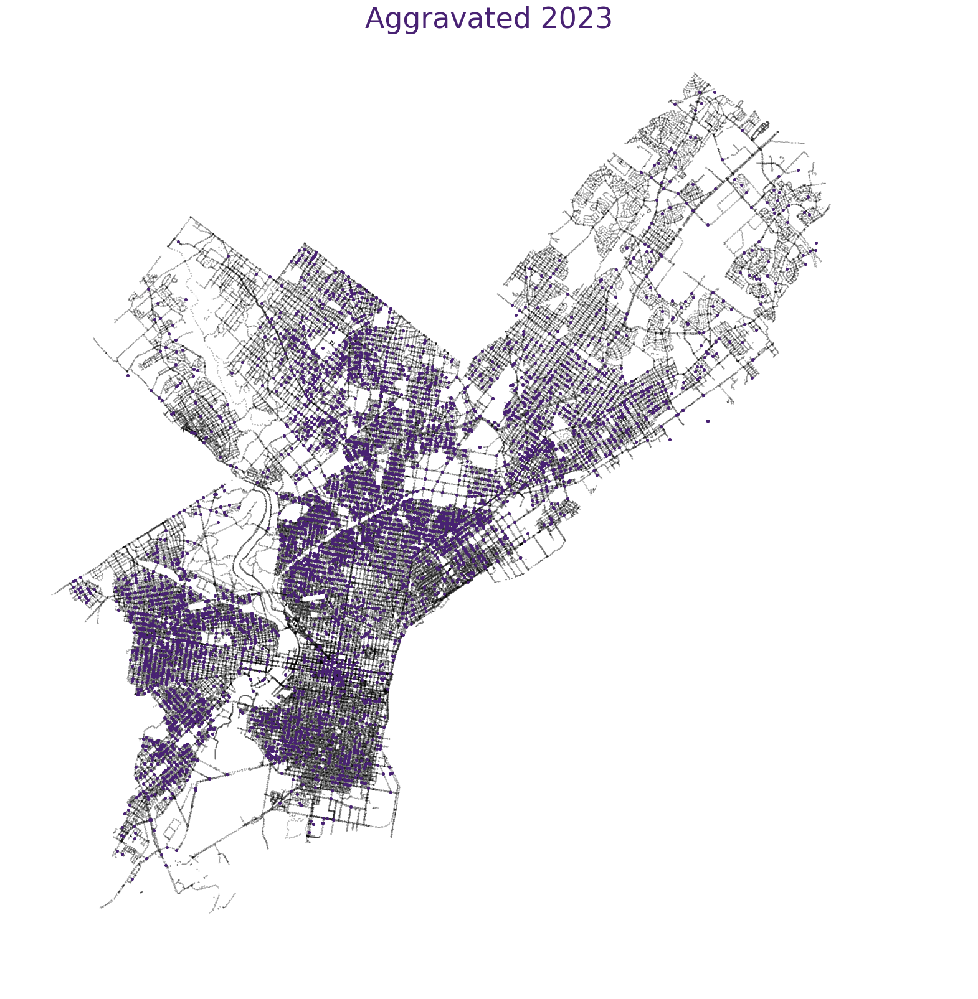

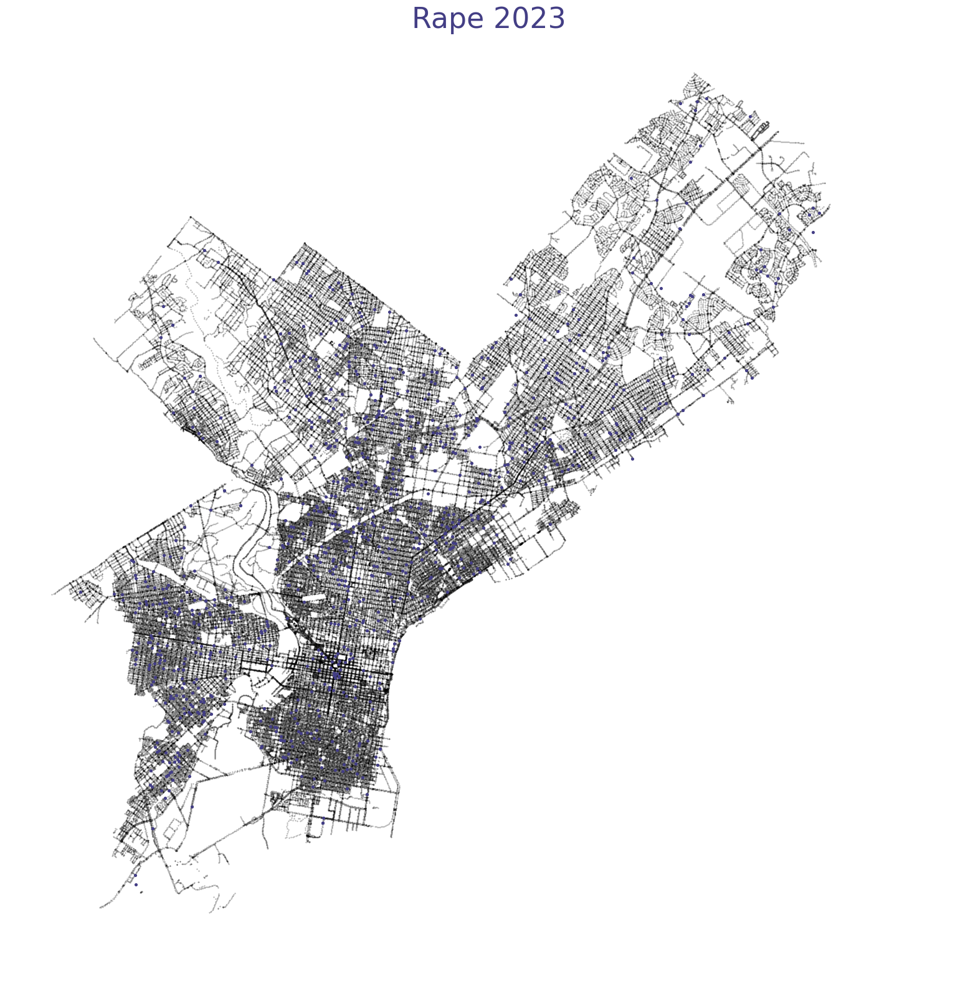

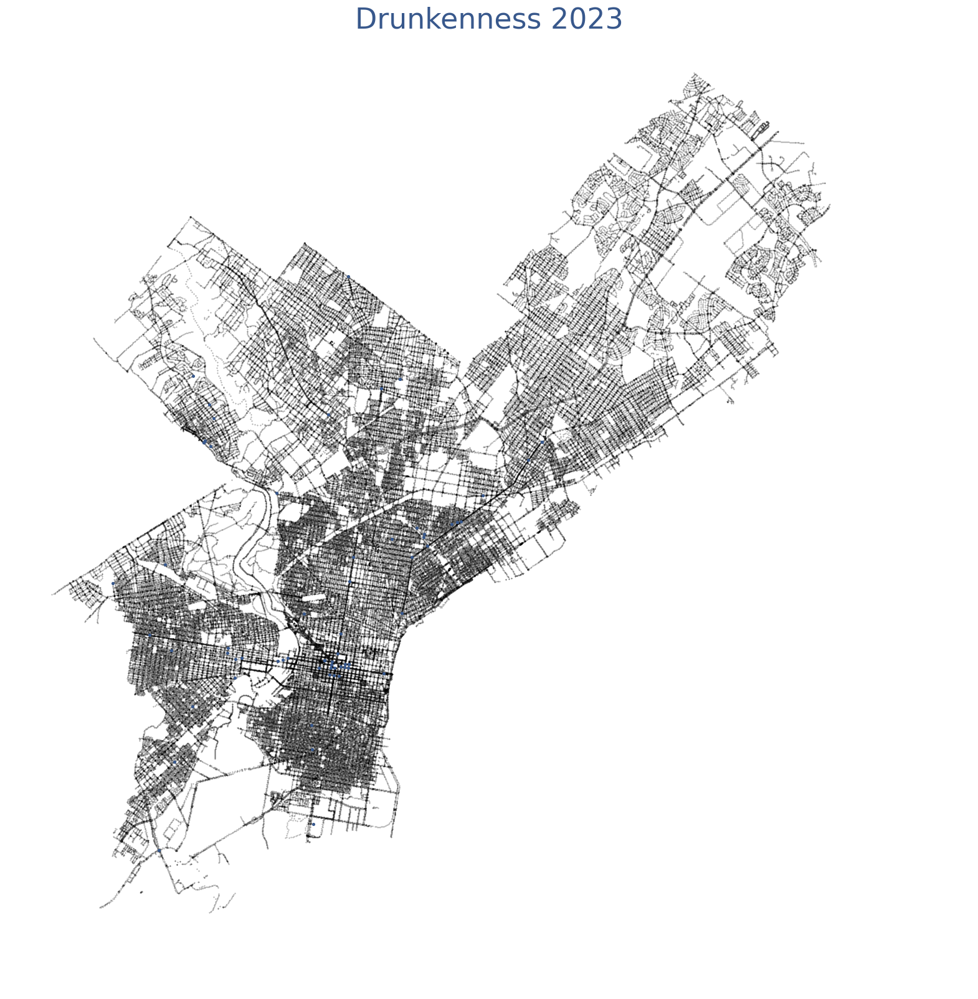

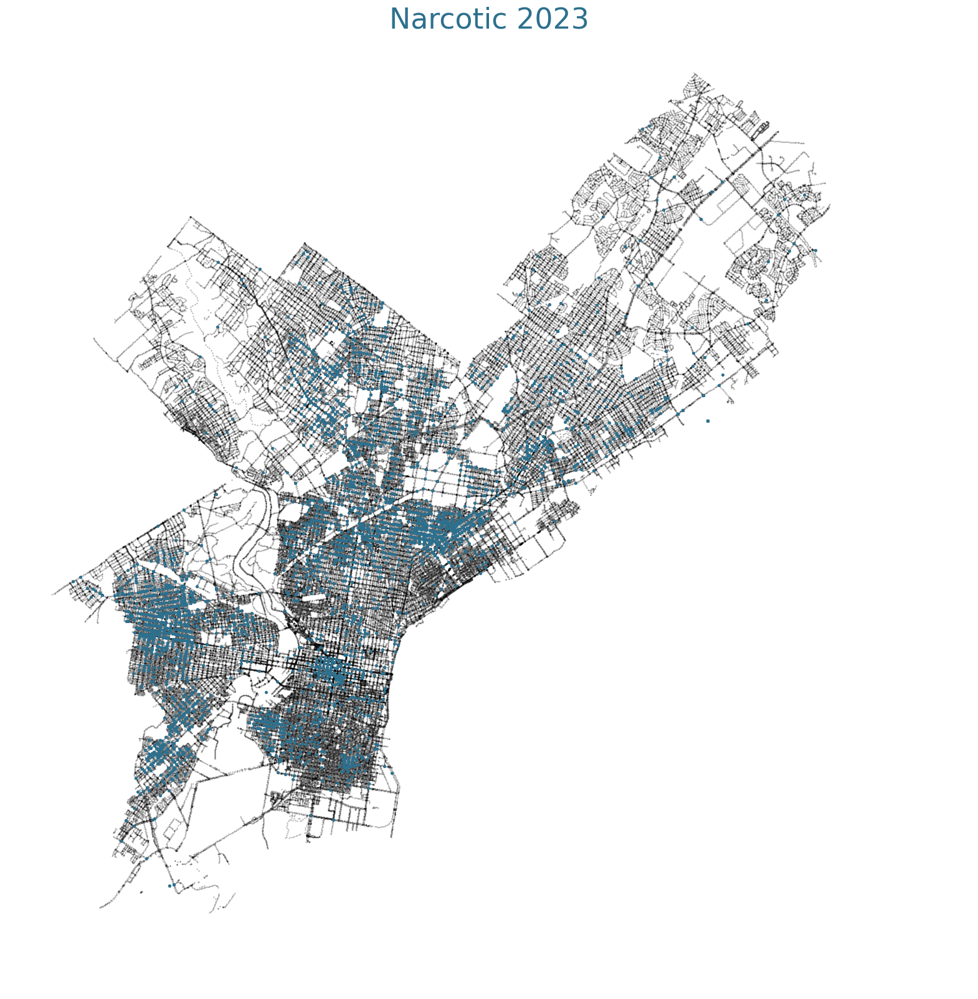

...

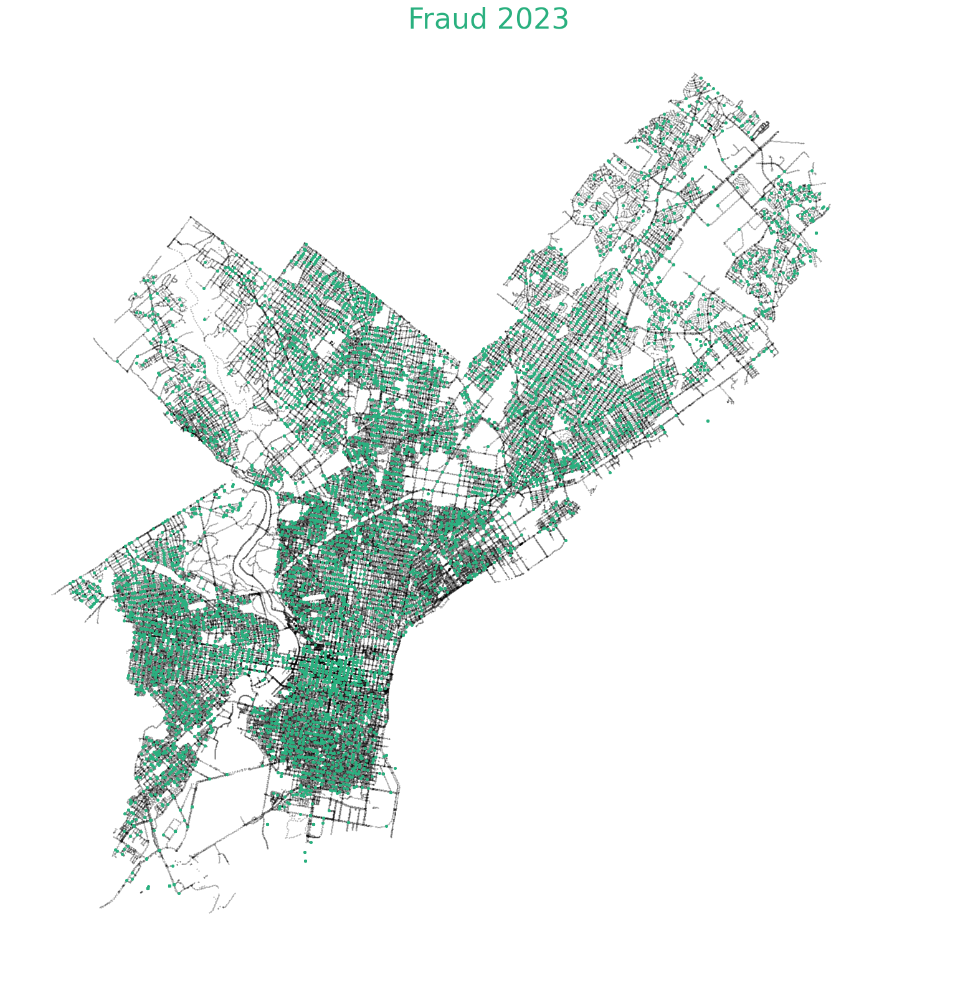

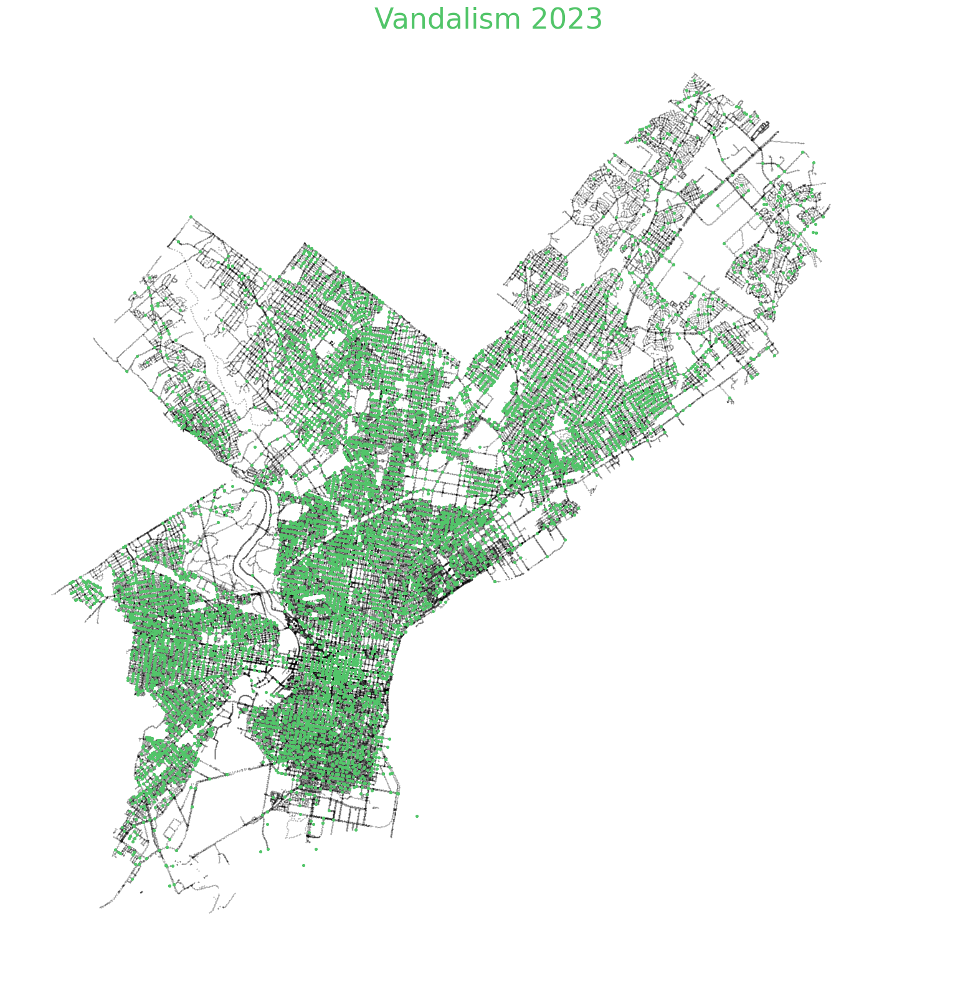

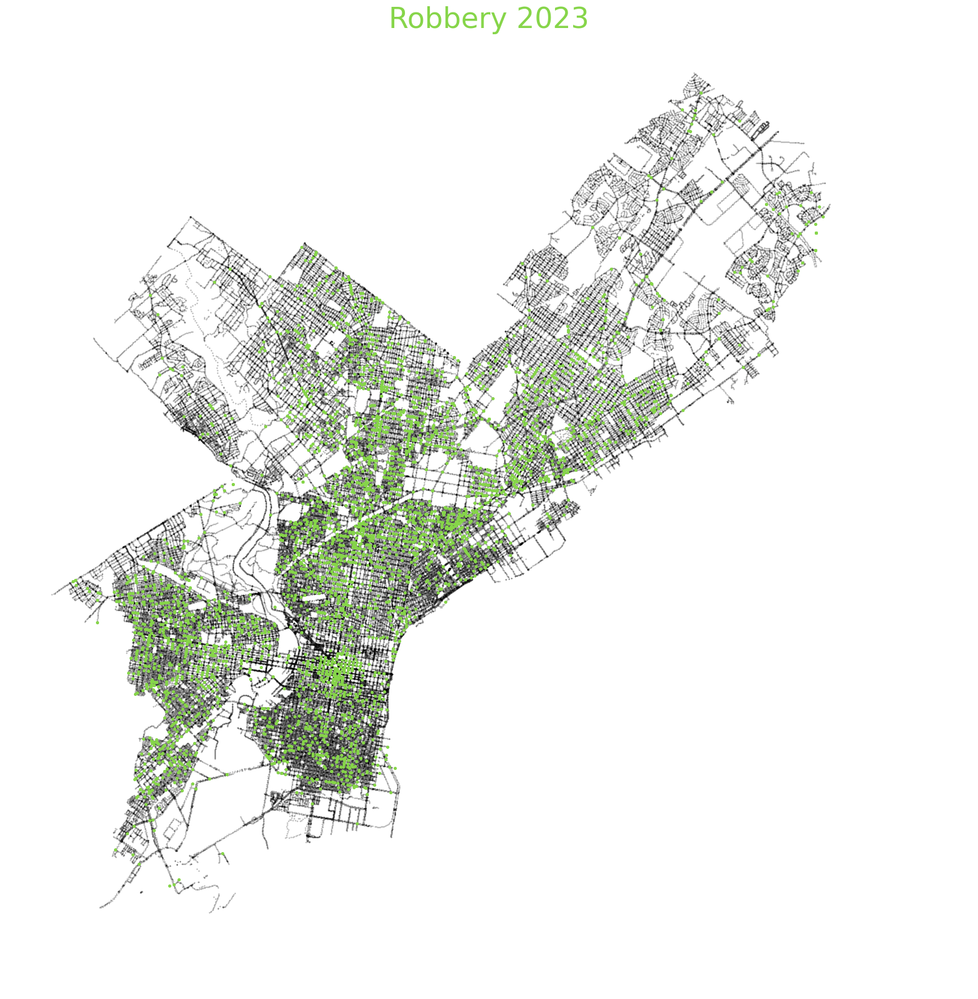

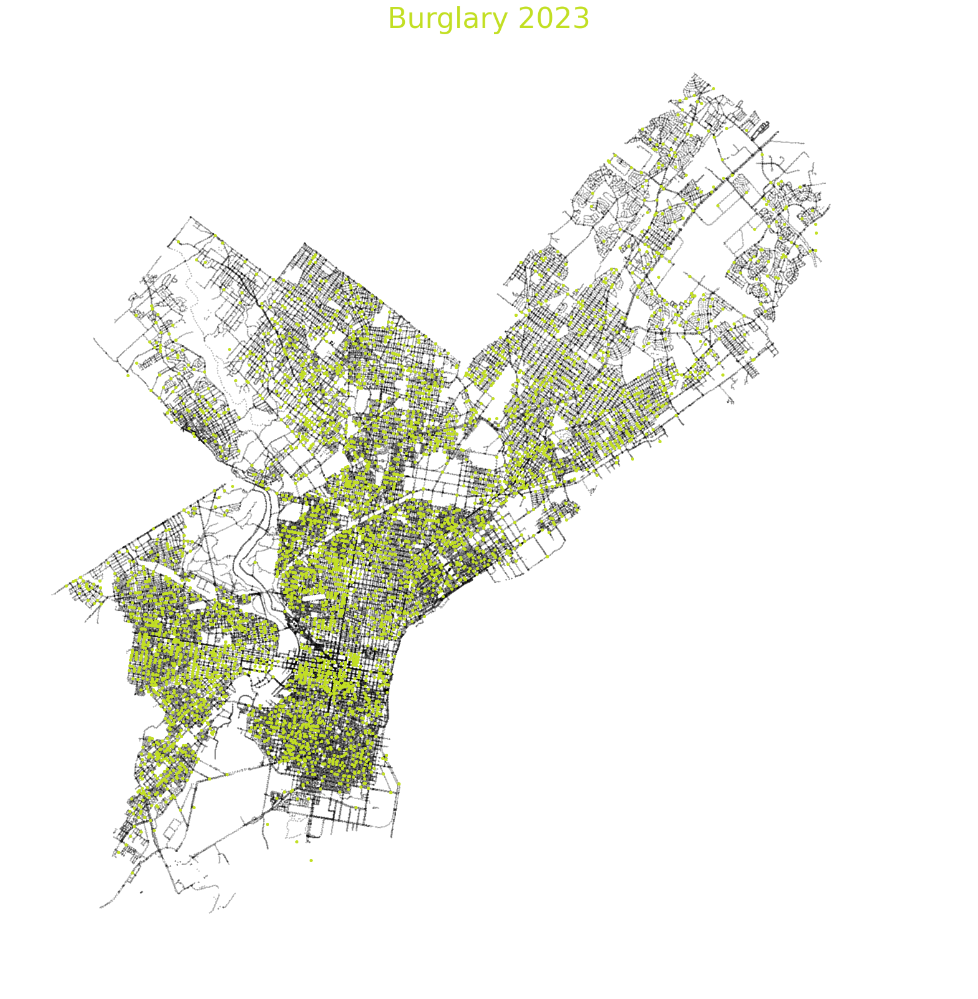

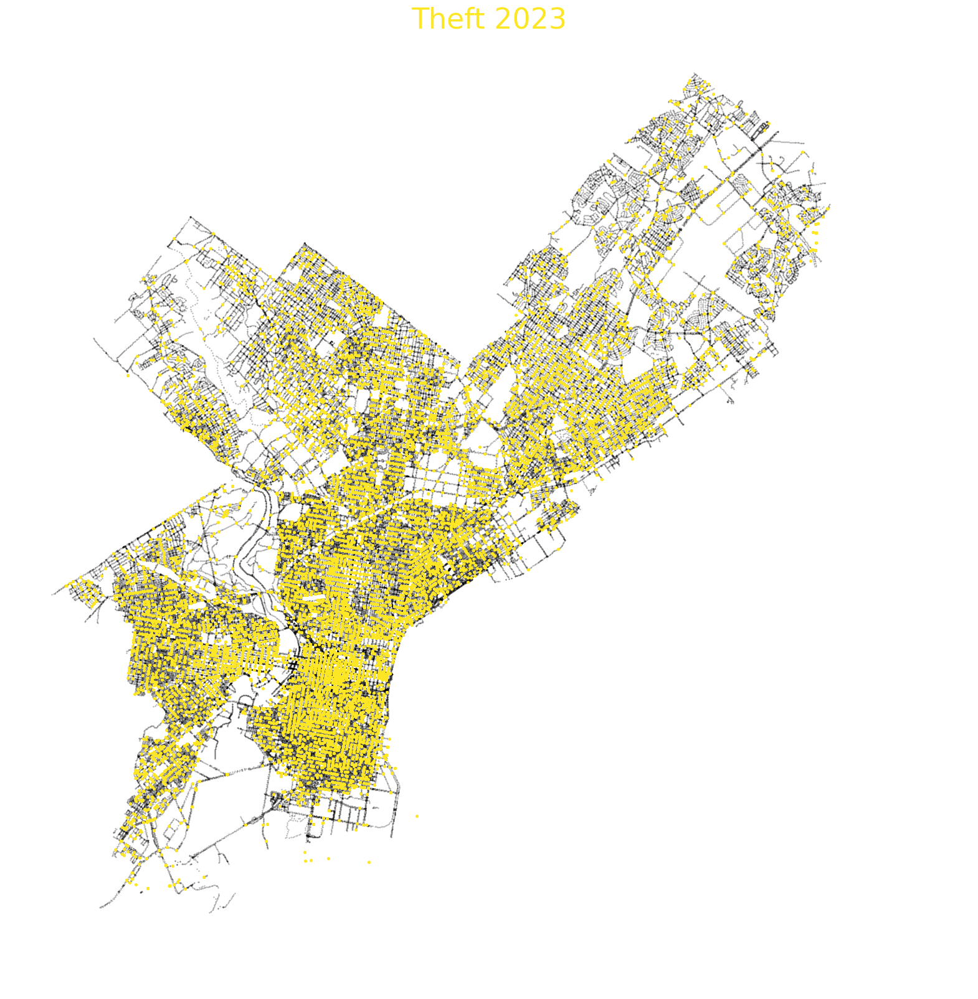

In [10]:
#inspired by https://carlessanchezalonso.github.io/2021/philadelphia-crime/
import numpy as np
from sklearn.neighbors import KernelDensity
import matplotlib.pyplot as plt
import pandas as pd

# Assuming incidents is a pandas DataFrame with the relevant data
data_crime = incidents
mask_area = ((data_crime['point_x'] > -75.3) & (data_crime['point_x'] < -74.9) & 
             (data_crime['point_y'] > 39.85) & (data_crime['point_y'] < 40.15))
data_crime = data_crime[mask_area]

max_points = 20000
xbins, ybins = 500, 500  # Set the number of bins as integers
bandwidth = 0.001

# Define a unique color for each type of crime
colors = plt.cm.get_cmap('viridis', len(crimes_names))

for k, crime in enumerate(crimes_names):
    # Filter data by crime
    crime_data = data_crime[data_crime['text_general_code'].str.contains(crime)]

    # If there are more points than max_points, randomly sample
    if len(crime_data) > max_points:
        crime_data = crime_data.sample(n=max_points)
    
    X_crime = crime_data['point_x'].values
    Y_crime = crime_data['point_y'].values
    XY_crime = np.array([X_crime, Y_crime]).T

    # Create grid for KDE
    x_min, x_max = X_crime.min(), X_crime.max()
    y_min, y_max = Y_crime.min(), Y_crime.max()
    x_grid = np.linspace(x_min, x_max, xbins)
    y_grid = np.linspace(y_min, y_max, ybins)
    xx, yy = np.meshgrid(x_grid, y_grid)
    xy_sample = np.vstack([xx.ravel(), yy.ravel()]).T

    # KDE
    kde_skl = KernelDensity(bandwidth=bandwidth)
    kde_skl.fit(XY_crime)

    z = np.exp(kde_skl.score_samples(xy_sample))
    zz = z.reshape(xx.shape)

    plt.figure(figsize=(20, 20))
    plt.scatter(X_poles, Y_poles, 0.1, c='k', alpha=0.6)
    plt.scatter(X_crime, Y_crime, 7, c=colors(k), vmax=np.percentile(z, 95))
    plt.xlim(-75.3, -74.9)
    plt.ylim(39.85, 40.15)
    plt.axis('off')
    plt.title(f'{crime} 2023', size=33, color=colors(k))

plt.show()



In [8]:
df = pd.read_csv('crime.csv')
df.head()

,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat
0,18,3,2009-10-02 14:24:00,2009-10-02,14:24:00,14,200918067518,S 38TH ST / MARKETUT ST,800.0,Other Assaults,NaN,2009-10,NaN,NaN
1,14,1,2009-05-10 00:55:00,2009-05-10,00:55:00,0,200914033994,8500 BLOCK MITCH,2600.0,All Other Offenses,NaN,2009-05,NaN,NaN
2,25,J,2009-08-07 15:40:00,2009-08-07,15:40:00,15,200925083199,6TH CAMBRIA,800.0,Other Assaults,NaN,2009-08,NaN,NaN
3,35,D,2009-07-19 01:09:00,2009-07-19,01:09:00,1,200935061008,5500 BLOCK N 5TH ST,1500.0,Weapon Violations,20.0,2009-07,-75.130477,40.036389
4,9,R,2009-06-25 00:14:00,2009-06-25,00:14:00,0,200909030511,1800 BLOCK WYLIE ST,2600.0,All Other Offenses,8.0,2009-06,-75.166350,39.969532
